In [3]:
import numpy as np
import matplotlib.pyplot as plt
from datetime import datetime, date, time
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import cv2
import math
import os
import random
from PIL import Image
import tensorflow as tf
import os
import json
import tensorflow as tf
import tensorflow.contrib.slim as slim
import os.path as path
import os
import json
from random import randint
import time

import numpy as np
import matplotlib.pyplot as plt
from IPython import display

from skimage.draw import polygon
import skimage.io as sio
from pycocotools.coco import COCO

from PIL import Image


In [4]:
os.chdir("../../../")

In [5]:
from src.utils.drawer import Drawer 
from src.utils.pose import Pose2D
from src.utils.body_cover import BodyCover

In [109]:
class PoseTrackProvider:
    
    
    def __init__(self, poseTrackDataPath='dataset/posetrack/posetrack_data'):
        
        self.posetrack_home_fp = path.expanduser(poseTrackDataPath)
        self.posetrack_annotations_fp = os.path.join(self.posetrack_home_fp, 'annotations')
        
        assert(os.path.exists(self.posetrack_home_fp))
        assert(os.path.exists(self.posetrack_annotations_fp))
        
        
        
        # build train 
        
        self.trainset = []
        
        trainDir = os.path.join(self.posetrack_annotations_fp, 'train')
        
        for fileName in os.listdir(trainDir)[:10]:#TODO
            currSeq = self._getCocoSequence(os.path.join(trainDir, fileName))
            imgMetas = self._getImagesMetadata(currSeq)
            imgFiles = [path.join(self.posetrack_home_fp, imageMeta['file_name']) for imageMeta in imgMetas]
            annots = self._getAnnotations(currSeq)
            
            self.trainset.append({'imgFiles':imgFiles, 'annotations':annots})
        
        
        # build test
        
        self.testset = []
        
        testDir = os.path.join(self.posetrack_annotations_fp, 'test')
        
        for fileName in os.listdir(testDir)[:10]:#TODO
            currSeq = self._getCocoSequence(os.path.join(testDir, fileName))
            imgMetas = self._getImagesMetadata(currSeq)
            imgFiles = [path.join(self.posetrack_home_fp, imageMeta['file_name']) for imageMeta in imgMetas]
            annots = self._getAnnotations(currSeq)
            
            self.testset.append({'imgFiles':imgFiles, 'annotations':annots})
            
    
    def trainsetSize(self):
        return len(self.trainset)
    
    def testsetSize(self):
        return len(self.testset)
    
    def getTrainSequence(self, seqId):
        return self.trainset[seqId]
    
    def getTestSequence(self, seqId):
        return self.testset[seqId]

        
    def _getCocoSequence(self, seqPath):
        return COCO(seqPath)


    def _getImagesMetadata(self, cocoSequence):

        img_ids = cocoSequence.getImgIds()
        imgs = cocoSequence.loadImgs(img_ids)
        posetrack_images = []

        for img in imgs:
            if not img['is_labeled']: 
                pass
            else:
                posetrack_images.append(img)

        return posetrack_images


    def _readImage(self, imageMeta):
        return sio.imread(path.join(self.posetrack_home_fp, imageMeta['file_name']))


    def _getAnnotations(self, cocoSequence):

        imageMetaSeq = self._getImagesMetadata(cocoSequence)

        if len(imageMetaSeq)==0:
            return results

        results = {}
        # process the sequences
        for image_idx, selected_im in enumerate(imageMetaSeq):
            ann_ids = cocoSequence.getAnnIds(imgIds=selected_im['id'])
            anns = cocoSequence.loadAnns(ann_ids)
            for ann_idx, ann in enumerate(anns):
                results[ann['track_id']] = []
                
        for image_idx, selected_im in enumerate(imageMetaSeq):

            # PIL faster for height/width (lazy)
            width, height = Image.open(path.join(self.posetrack_home_fp, selected_im['file_name'])).size

            ann_ids = cocoSequence.getAnnIds(imgIds=selected_im['id'])
            anns = cocoSequence.loadAnns(ann_ids)
            
            track_id_to_ann = {}
            for ann in anns:
                track_id_to_ann[ann['track_id']] = ann

            for trackId in results:
                if trackId in track_id_to_ann and 'keypoints' in track_id_to_ann[trackId] and type(track_id_to_ann[trackId]['keypoints']) == list:
                    # turn skeleton into zero-based index
                    ann = track_id_to_ann[trackId]
                    sks = np.array(cocoSequence.loadCats(ann['category_id'])[0]['skeleton'])-1
                    kp = np.array(ann['keypoints'])
                    x = np.expand_dims(kp[0::3],1)/float(width)
                    y = np.expand_dims(kp[1::3],1)/float(height)
                    isAnnotated = kp[2::3] > 0 
                    joints = np.concatenate([x,y], 1)
                    joints[~isAnnotated, : ] = -1
                    newPose = Pose2D.build_from_coco(joints)
                    results[trackId].append({'pose':newPose, 'isActive':newPose.total_labeled_joints()==13})
                else:
                    results[trackId].append({'pose':None, 'isActive':False})

        return results


In [110]:
ptPro = PoseTrackProvider()

loading annotations into memory...
Done (t=0.02s)
creating index...
index created!
loading annotations into memory...
Done (t=0.01s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.02s)
creating index...
index created!
loading annotations into memory...
Done (t=0.01s)
creating index...
index created!
loading annotations into memory...
Done (t=0.01s)
creating index...
index created!
loading annotations into memory...
Done (t=0.01s)
creating index...
index created!
loading annotations into memory...
Done (t=0.01s)
creating index...
index created!
loading annotations into memory...
Done (t=0.03s)
creating index...
index created!
loading annotations into memory...
Done (t=0.01s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
load

In [115]:
class DataProvider:
    
    
    def __init__(self, pt_pro, body_cover, history_ids=[0,1,2,3,8,15,20]):
        
        self.pt_pro = pt_pro
        self.history_ids = history_ids
        self.total_required_frames = max(history_ids)+1
        self.training = self._build(pt_pro.trainsetSize(), pt_pro.getTrainSequence, body_cover, 0.3)
    
    
    
    def _build(self, sequence_size, sequence_provider, body_cover, subject_padding):
        
        results = []
        
        # training seq
        for seq_id in range(sequence_size):
            
            annot_seqs = sequence_provider(seq_id)['annotations']
            annot_images = sequence_provider(seq_id)['imgFiles']
            
            for track_id in annot_seqs.keys():
                print(str(seq_id)+" : "+str(track_id))
                
                for frame_id in range(0,len(annot_seqs[track_id])-self.total_required_frames):
                    
                    is_active_on_history = True
                    
                    for req_hist_id in self.history_ids: 
                        curr_frame_id = frame_id+req_hist_id
                        is_active_on_history = is_active_on_history and annot_seqs[track_id][curr_frame_id]['isActive']
                    
                    if is_active_on_history:  
                        
                        valid_annot = {'images':[], 'poses':[]}
                        
                        for req_hist_id in self.history_ids: 
                            
                            curr_frame_id = frame_id+req_hist_id
                            
                            curr_img = mpimg.imread(annot_images[curr_frame_id])
                            
                            curr_hero_pose = annot_seqs[track_id][curr_frame_id]['pose']
                            curr_hero_bbox = curr_hero_pose.to_bbox()
                            curr_hero_bbox_padded = curr_hero_pose.to_bbox().to_squared(curr_img, subject_padding)
                            
                            curr_img_cropped = curr_hero_bbox_padded.crop(curr_img)
                            curr_img_cropped = curr_img_cropped.astype(np.uint8)
                            

                            curr_poses = [curr_hero_pose.to_relative_coordinate_into(curr_hero_bbox_padded)]
                            
                            tmp = curr_hero_bbox.translate(-curr_hero_bbox_padded.get_min_x(), -curr_hero_bbox_padded.get_min_y())
                            tmp = tmp.scale(1.0 / curr_hero_bbox_padded.get_width(), 1.0 / curr_hero_bbox_padded.get_height())
                                     
                            curr_bboxes = [tmp]
                            
                            for other_track_id in annot_seqs.keys():
                                
                                if other_track_id != track_id:

                                    other_pose = annot_seqs[other_track_id][curr_frame_id]['pose']

                                    if isinstance(other_pose, type(None)):
                                        continue
                                        
                                    if other_pose.total_labeled_joints() < 3:
                                        continue
                                    
                                    interbox = curr_hero_bbox_padded.intersect(other_pose.to_bbox())
                                    
                                    if isinstance(interbox, type(None)):
                                        continue
                                    
                                    interbox = interbox.translate(-curr_hero_bbox_padded.get_min_x(), -curr_hero_bbox_padded.get_min_y())
                                    interbox = interbox.scale(1.0 / curr_hero_bbox_padded.get_width(), 1.0 / curr_hero_bbox_padded.get_height())
                                    
                                    curr_bboxes.append(interbox)
                                    curr_poses.append(other_pose.to_relative_coordinate_into(curr_hero_bbox_padded))

                                
                            curr_img_cropped = body_cover.hide_strangers(curr_img_cropped, curr_bboxes, 0, all_poses=curr_poses)
                            
                            valid_annot['images'].append(curr_img_cropped)
                            valid_annot['poses'].append(curr_hero_pose.to_relative_coordinate_into(curr_hero_bbox_padded))
                        
                        results.append(valid_annot)
                        
        return results
                                        


In [112]:
ptPro.trainsetSize()

10

In [116]:
dp = DataProvider(ptPro, BodyCover(0.3))

0 : 0
0 : 1
0 : 2
0 : 3
0 : 4
add => 0
add => 1
add => 2
add => 3
add => 8
add => 15
add => 20
add => 0
add => 1
add => 2
add => 3
add => 8
add => 15
add => 20
add => 0
add => 1
add => 2
add => 3
add => 8
add => 15
add => 20
add => 0
add => 1
add => 2
add => 3
add => 8
add => 15
add => 20
add => 0
add => 1
add => 2
add => 3
add => 8
add => 15
add => 20
add => 0
add => 1
add => 2
add => 3
add => 8
add => 15
add => 20
add => 0
add => 1
add => 2
add => 3
add => 8
add => 15
add => 20
add => 0
add => 1
add => 2
add => 3
add => 8
add => 15
add => 20
add => 0
add => 1
add => 2
add => 3
add => 8
add => 15
add => 20
add => 0
add => 1
add => 2
add => 3
add => 8
add => 15
add => 20
0 : 5
add => 0
add => 1
add => 2
add => 3
add => 8
add => 15
add => 20
add => 0
add => 1
add => 2
add => 3
add => 8
add => 15
add => 20
0 : 6
0 : 7
0 : 8
0 : 9
0 : 10
add => 0
add => 1
add => 2
add => 3
add => 8
add => 15
add => 20
add => 0
add => 1
add => 2
add => 3
add => 8
add => 15
add => 20
add => 0
add => 1
add =

add => 1
add => 2
add => 3
add => 8
add => 15
add => 20
add => 0
add => 1
add => 2
add => 3
add => 8
add => 15
add => 20
add => 0
add => 1
add => 2
add => 3
add => 8
add => 15
add => 20
add => 0
add => 1
add => 2
add => 3
add => 8
add => 15
add => 20
add => 0
add => 1
add => 2
add => 3
add => 8
add => 15
add => 20
add => 0
add => 1
add => 2
add => 3
add => 8
add => 15
add => 20
add => 0
add => 1
add => 2
add => 3
add => 8
add => 15
add => 20
add => 0
add => 1
add => 2
add => 3
add => 8
add => 15
add => 20
add => 0
add => 1
add => 2
add => 3
add => 8
add => 15
add => 20
8 : 8
9 : 1
9 : 2
9 : 3
add => 0
add => 1
add => 2
add => 3
add => 8
add => 15
add => 20
add => 0
add => 1
add => 2
add => 3
add => 8
add => 15
add => 20
add => 0
add => 1
add => 2
add => 3
add => 8
add => 15
add => 20
add => 0
add => 1
add => 2
add => 3
add => 8
add => 15
add => 20
add => 0
add => 1
add => 2
add => 3
add => 8
add => 15
add => 20
add => 0
add => 1
add => 2
add => 3
add => 8
add => 15
add => 20
add => 0
a

In [101]:
len(dp.training)

23

============= new sequence


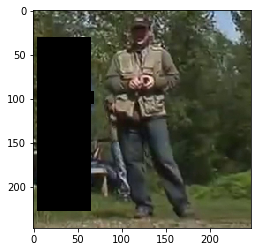

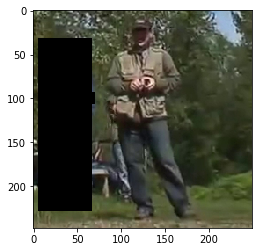

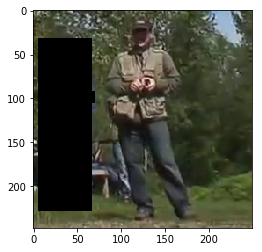

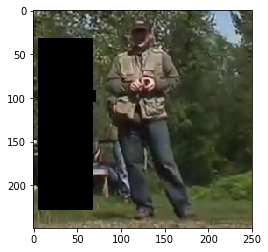

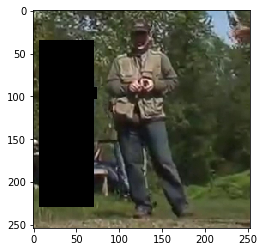

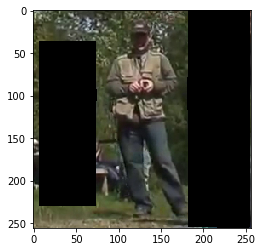

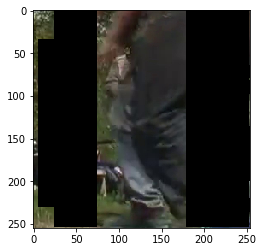

============= new sequence


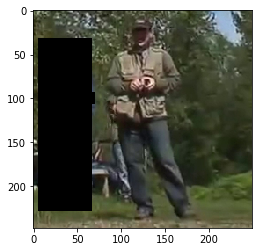

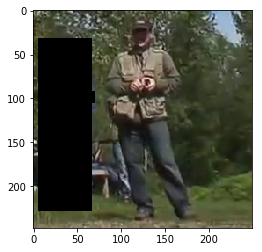

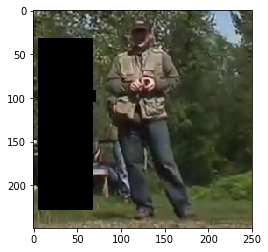

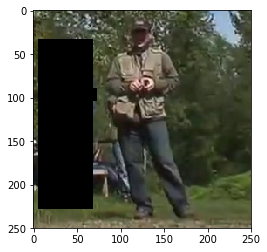

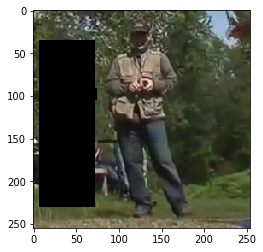

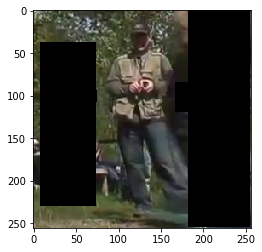

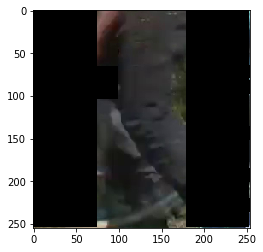

============= new sequence


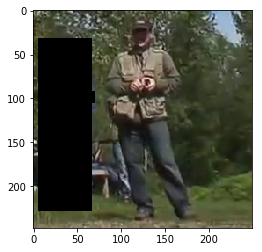

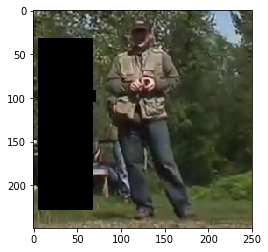

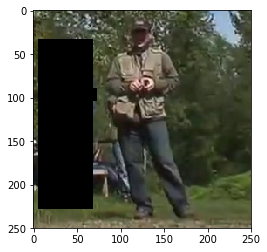

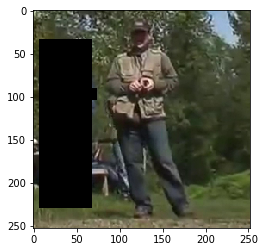

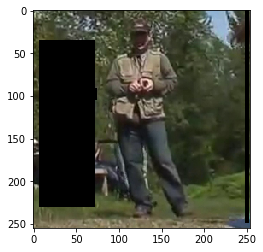

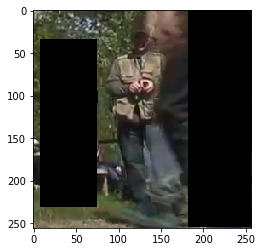

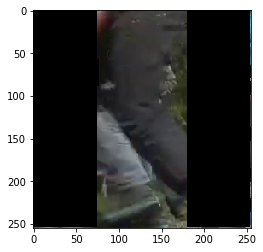

============= new sequence


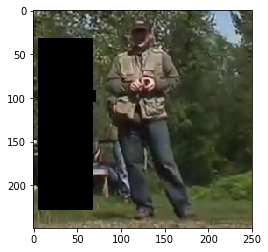

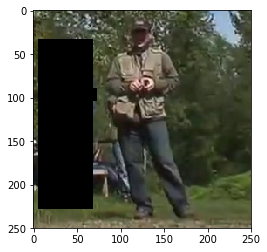

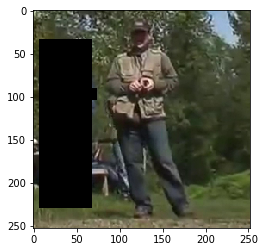

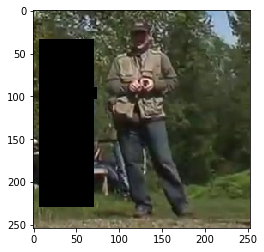

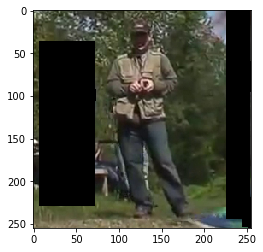

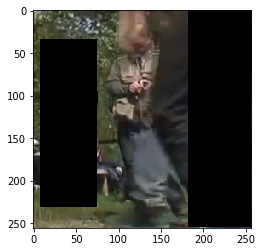

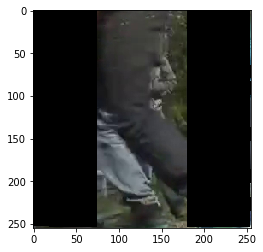

============= new sequence


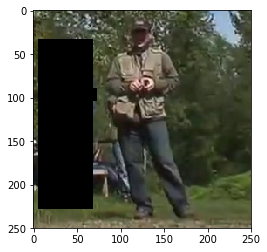

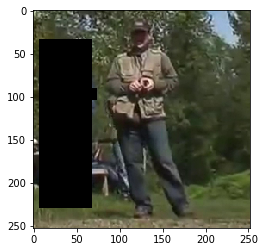

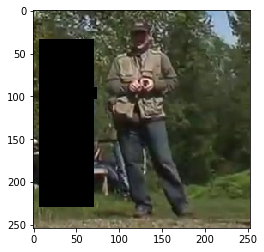

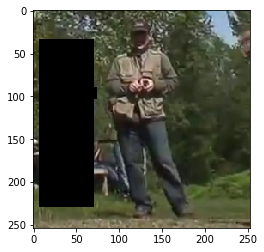

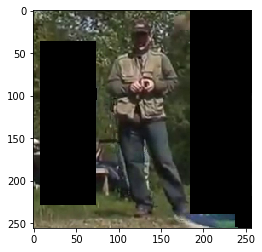

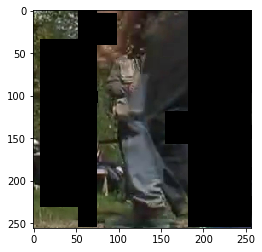

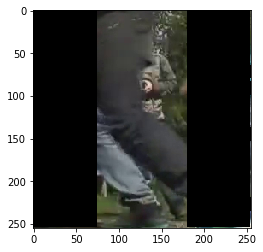

============= new sequence


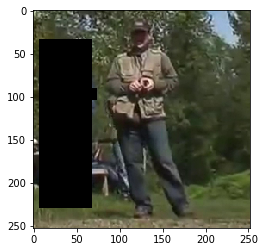

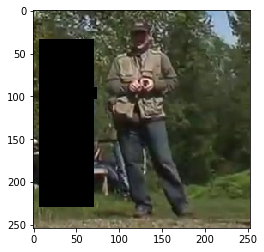

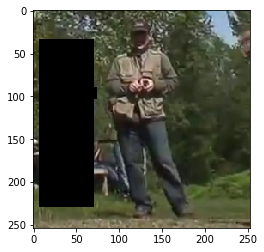

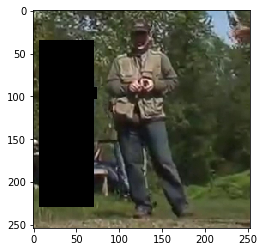

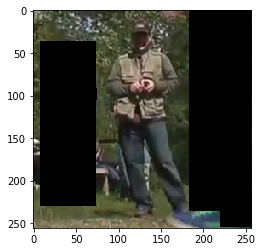

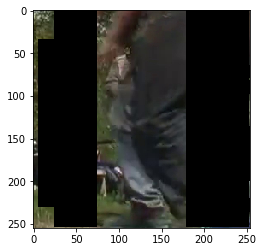

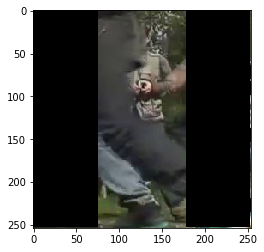

============= new sequence


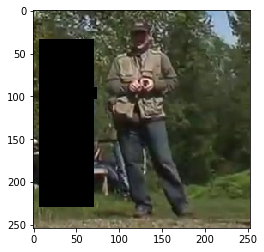

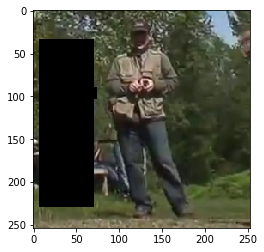

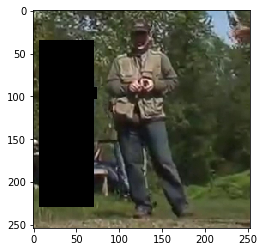

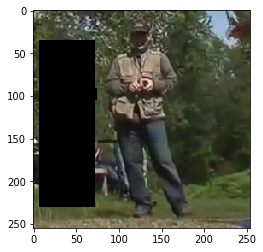

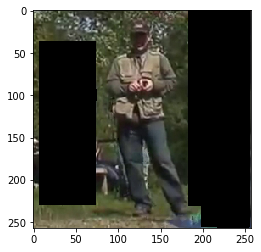

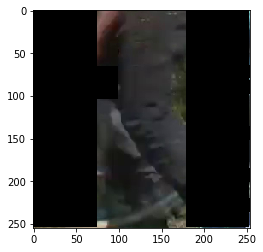

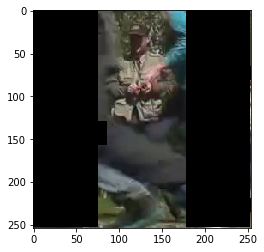

============= new sequence


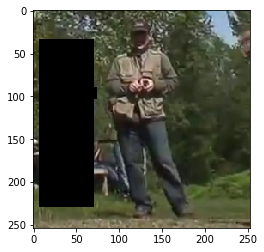

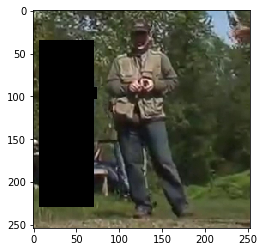

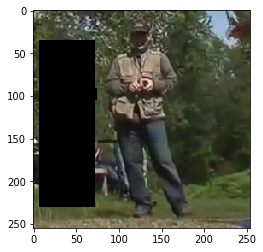

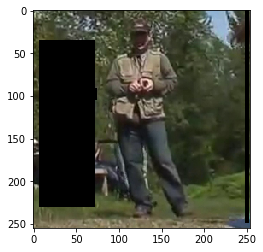

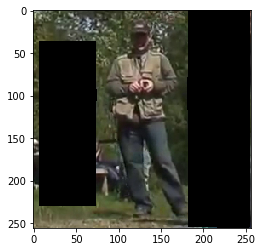

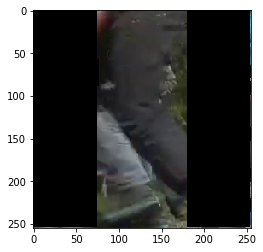

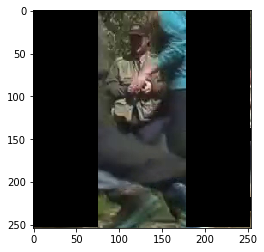

============= new sequence


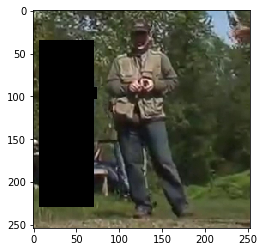

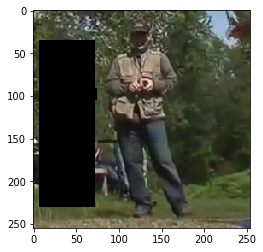

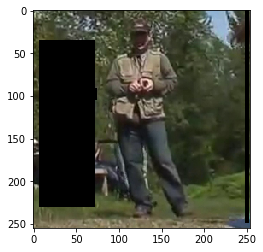

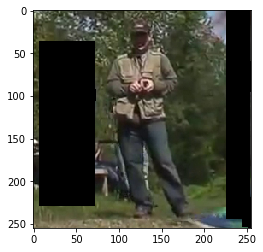

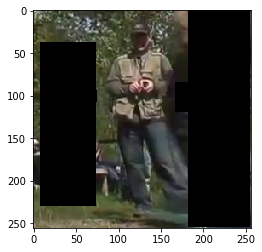

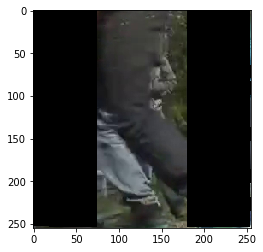

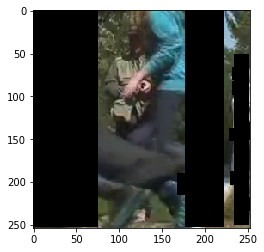

============= new sequence


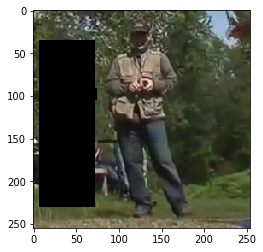

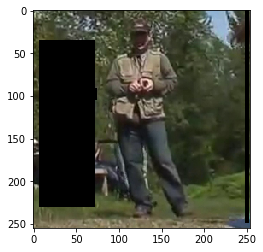

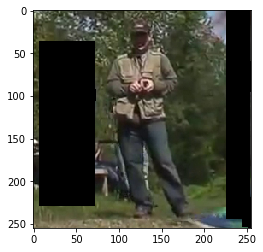

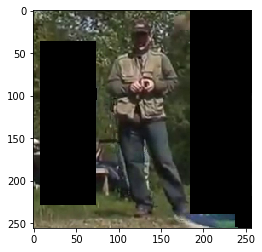

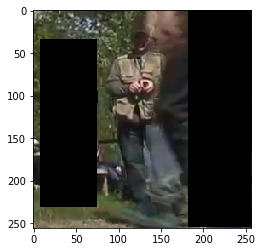

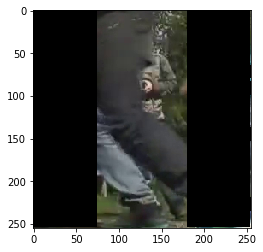

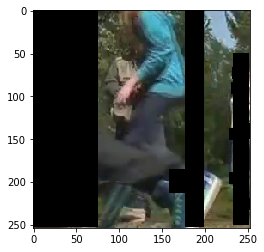

============= new sequence


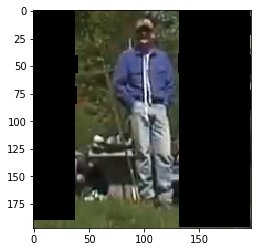

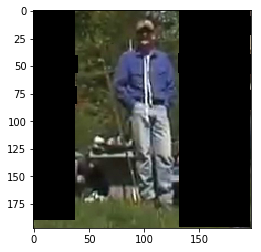

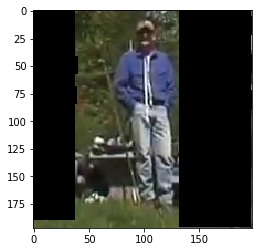

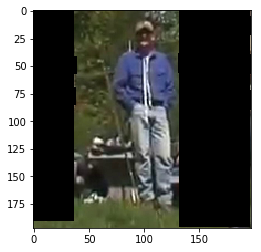

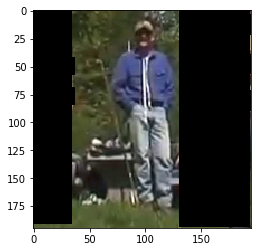

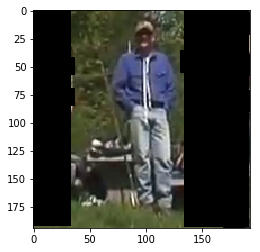

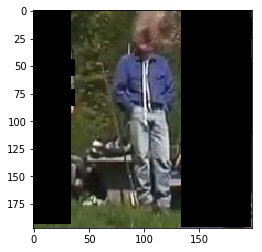

============= new sequence


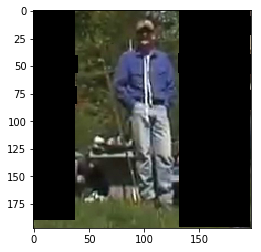

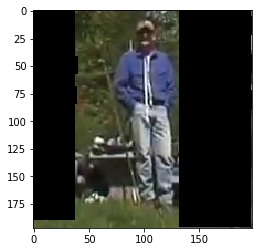

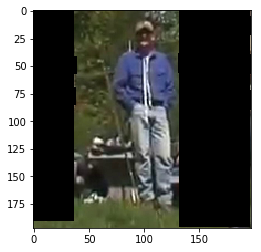

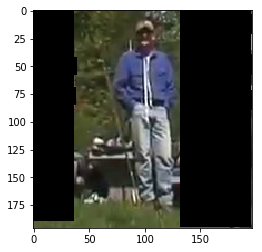

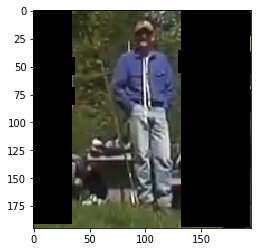

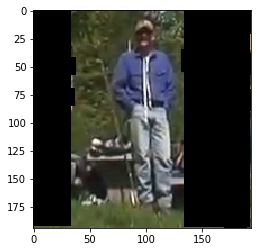

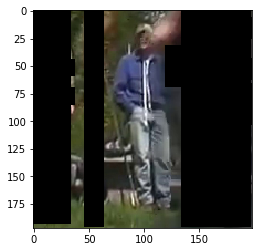

============= new sequence


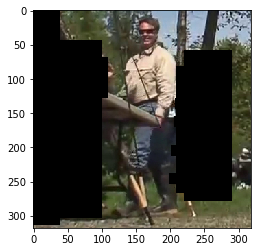

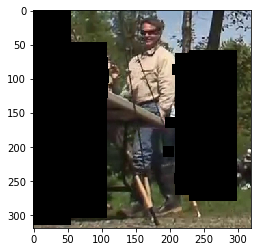

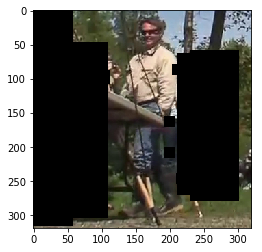

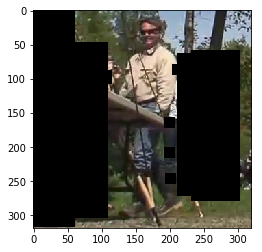

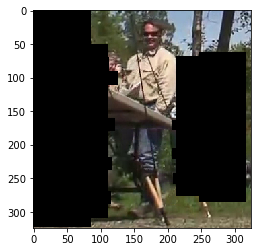

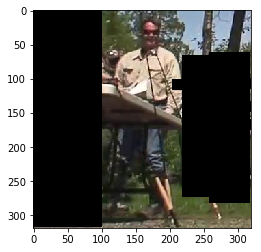

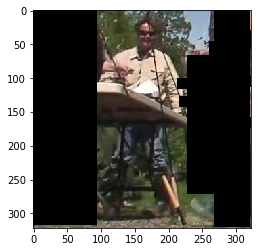

============= new sequence


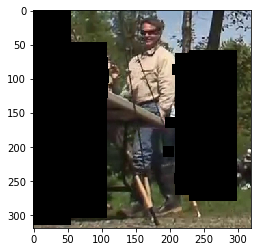

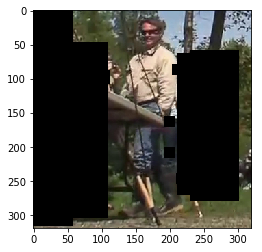

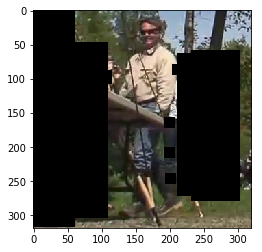

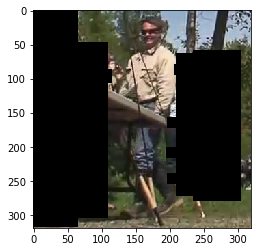

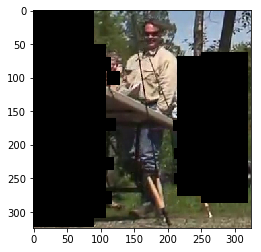

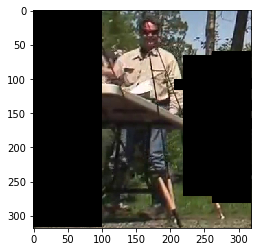

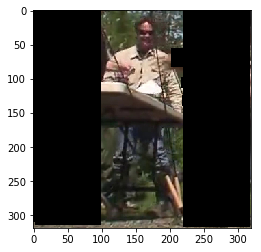

============= new sequence


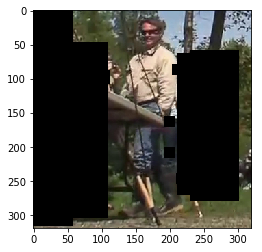

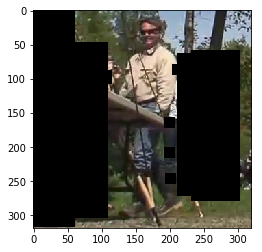

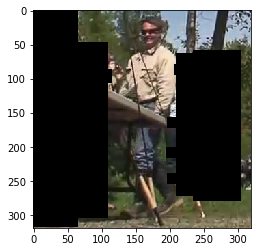

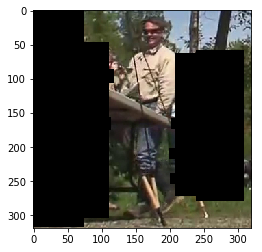

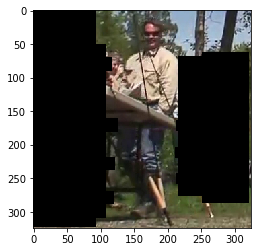

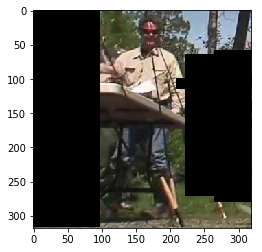

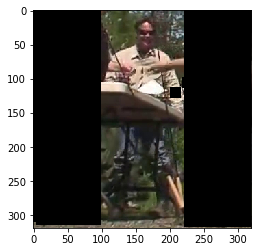

============= new sequence


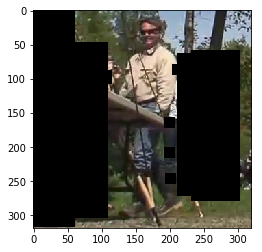

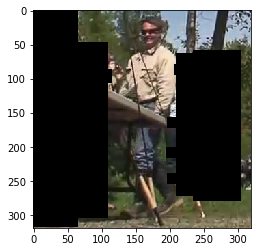

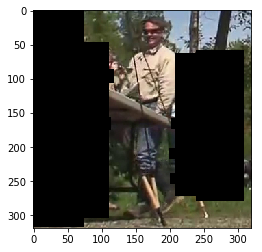

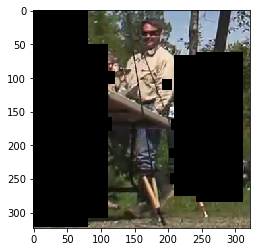

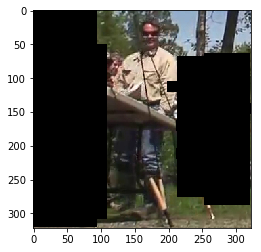

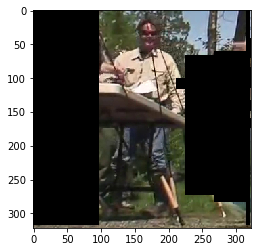

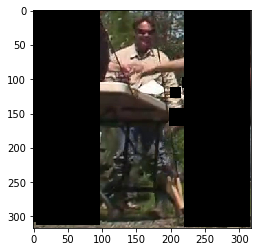

============= new sequence


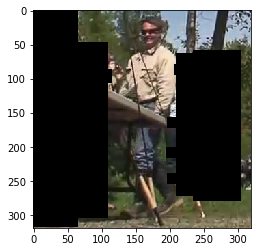

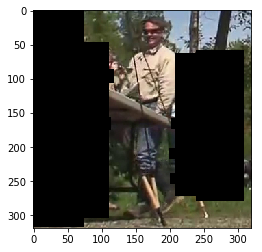

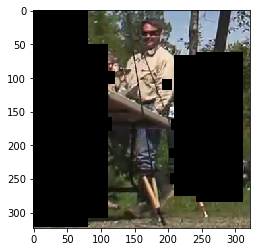

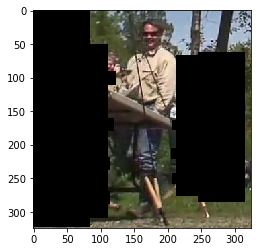

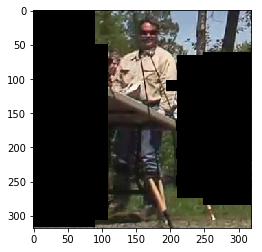

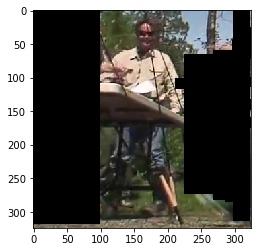

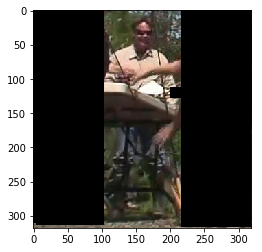

============= new sequence


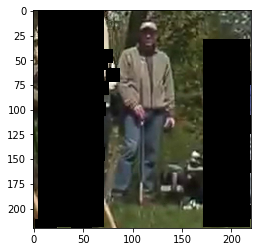

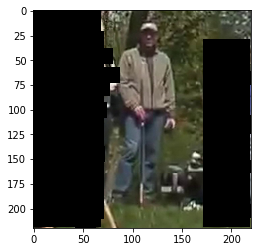

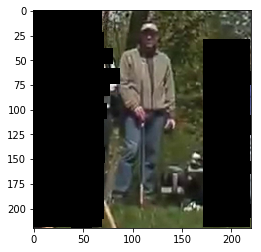

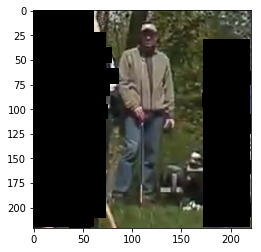

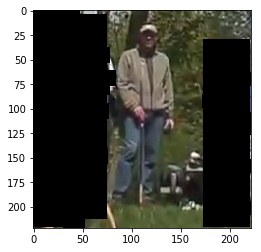

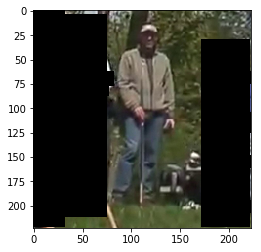

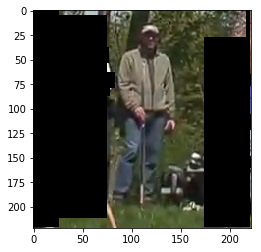

============= new sequence


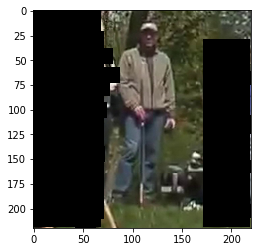

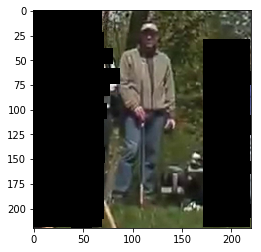

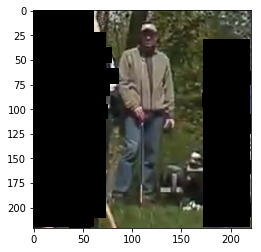

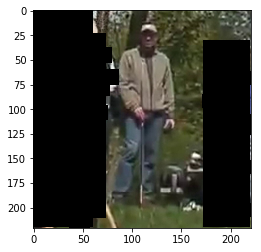

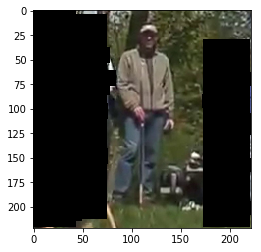

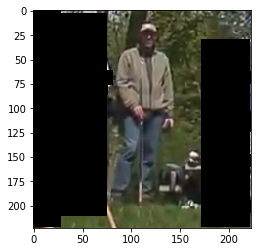

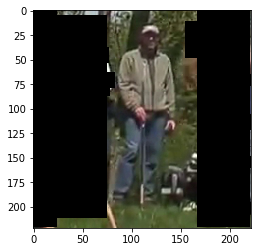

============= new sequence


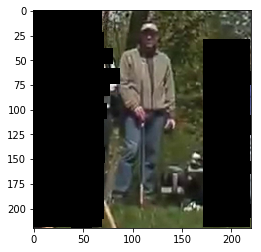

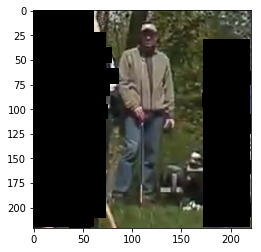

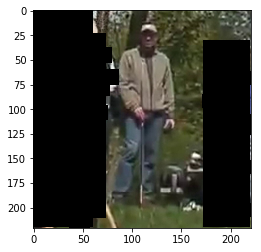

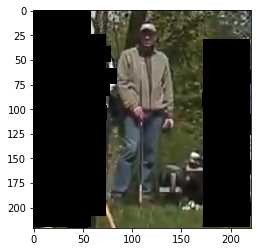

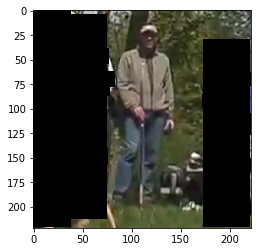

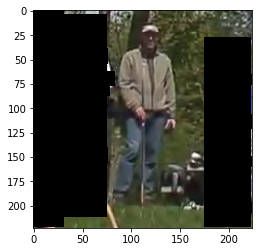

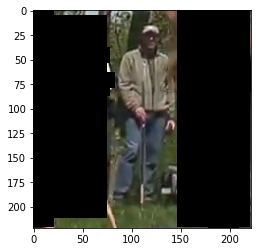

============= new sequence


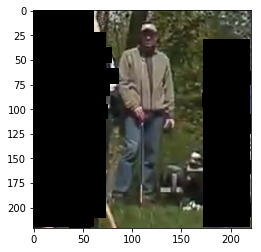

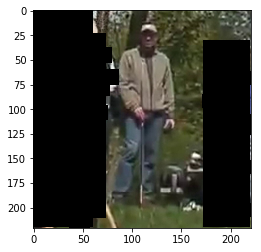

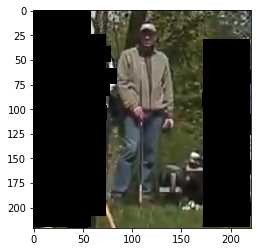

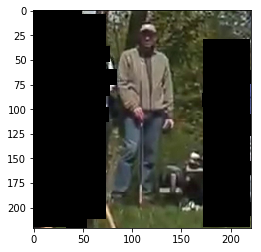

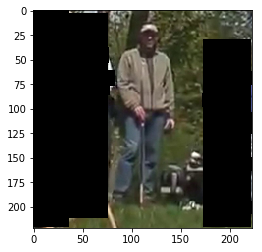

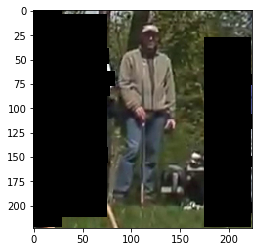

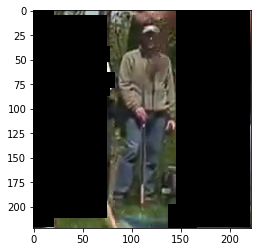

============= new sequence


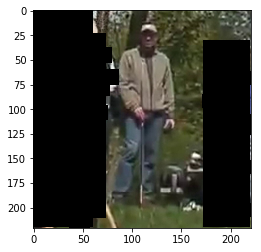

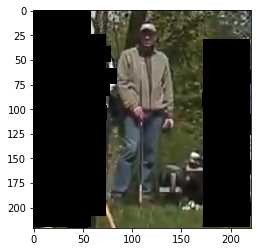

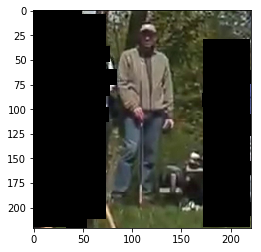

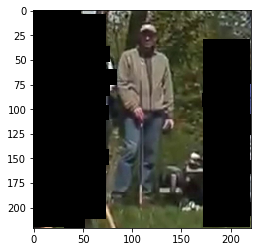

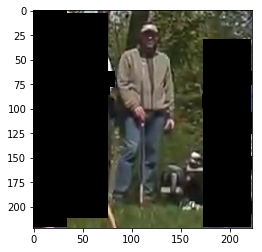

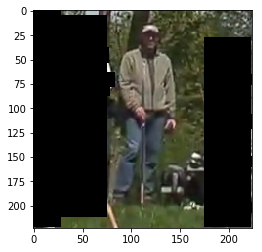

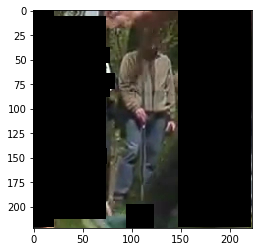

============= new sequence


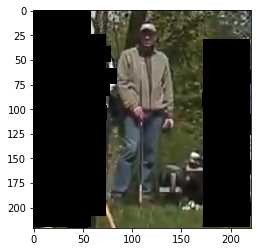

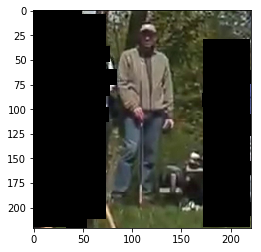

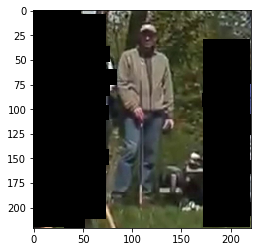

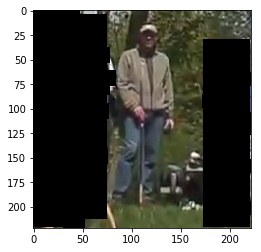

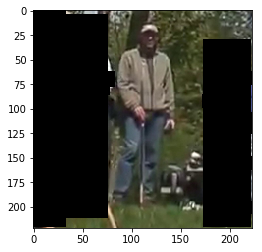

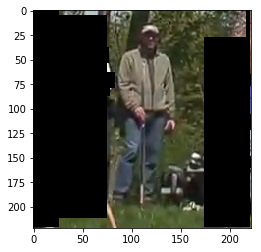

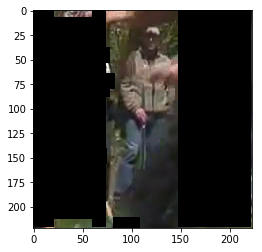

============= new sequence


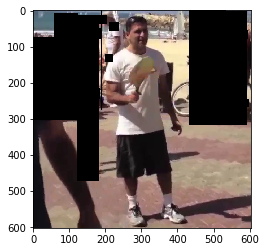

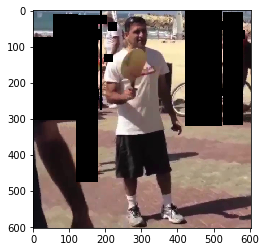

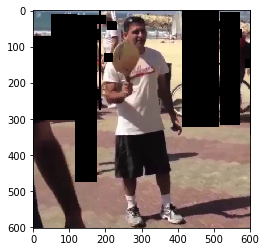

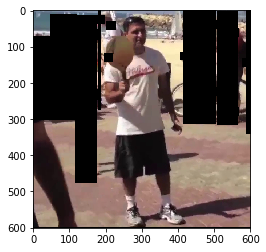

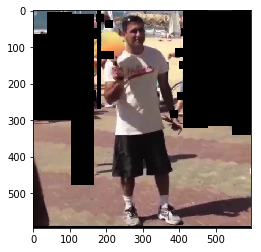

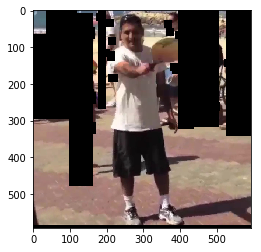

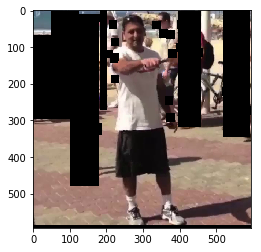

============= new sequence


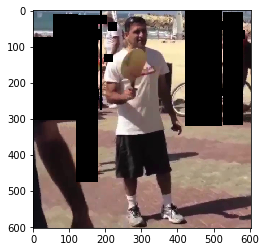

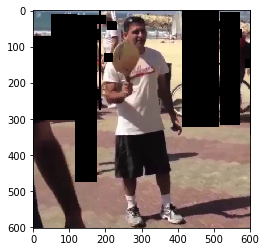

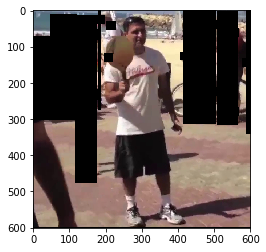

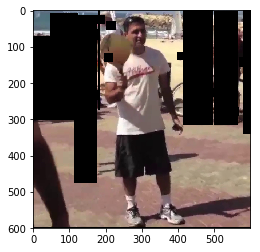

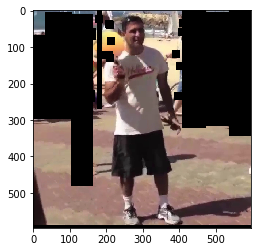

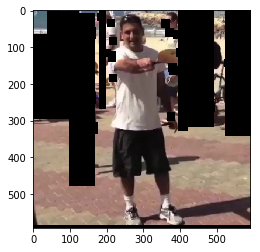

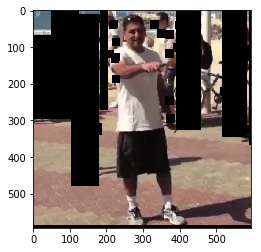

============= new sequence


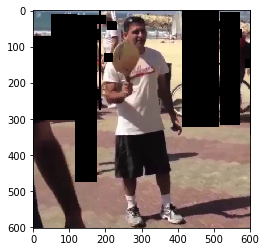

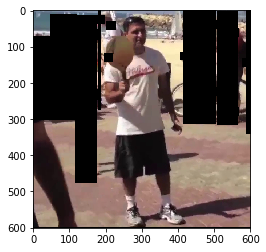

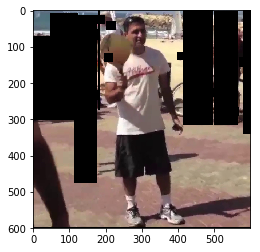

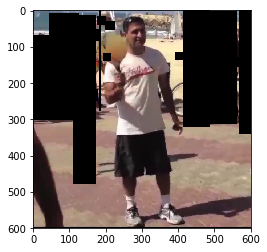

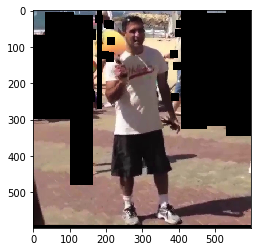

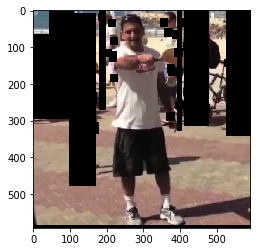

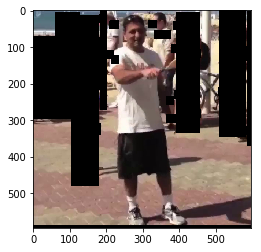

============= new sequence


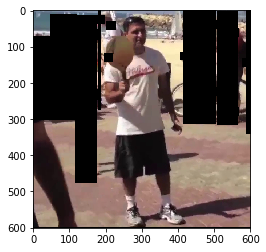

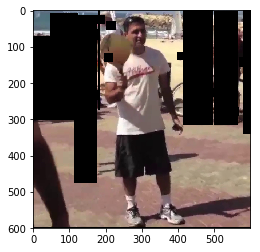

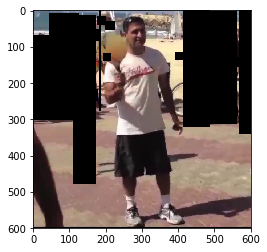

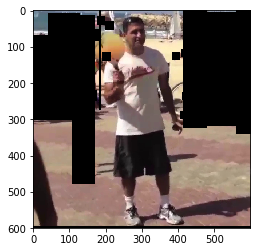

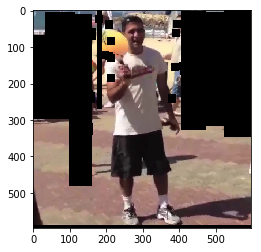

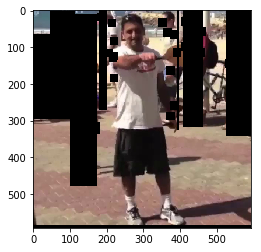

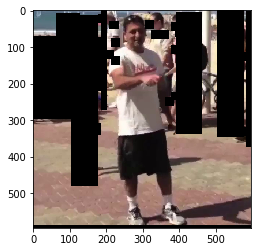

============= new sequence


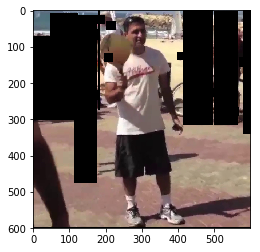

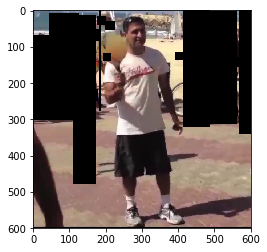

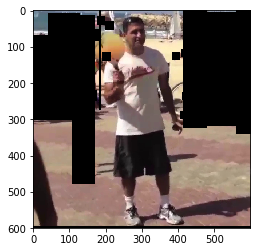

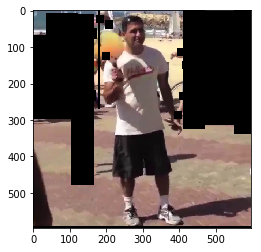

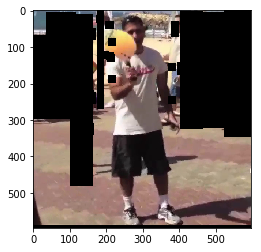

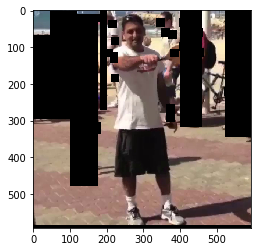

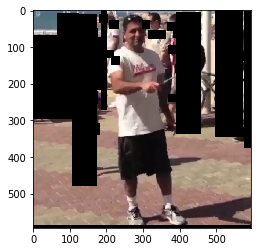

============= new sequence


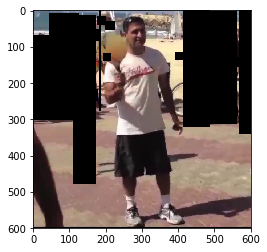

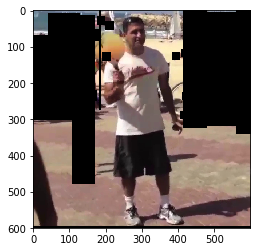

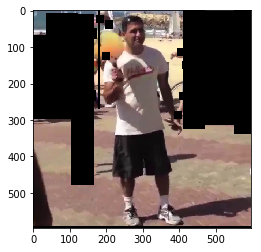

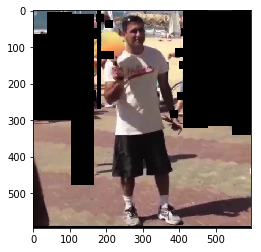

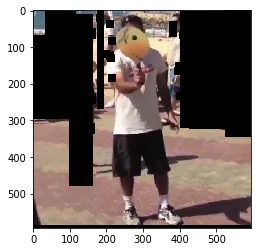

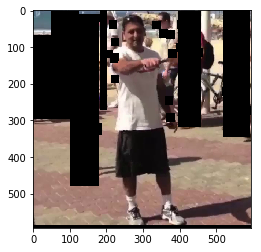

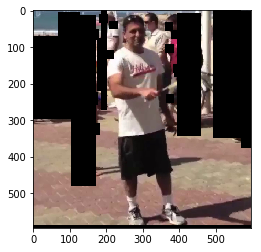

============= new sequence


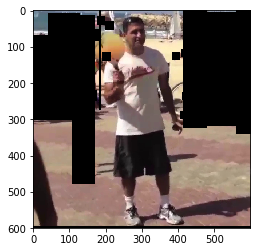

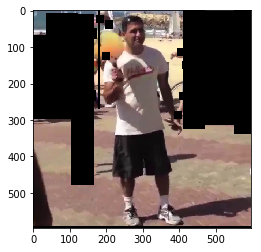

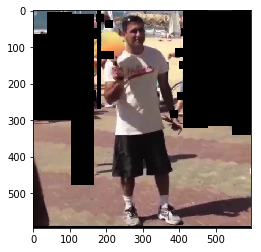

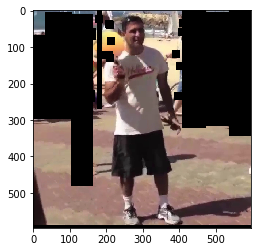

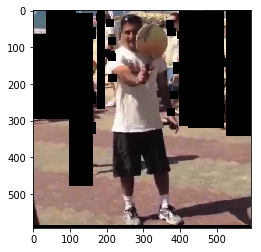

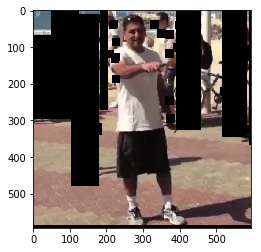

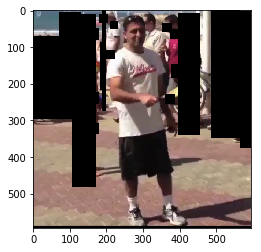

============= new sequence


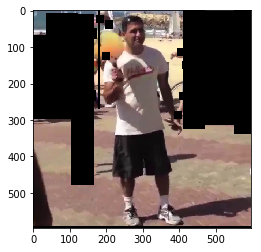

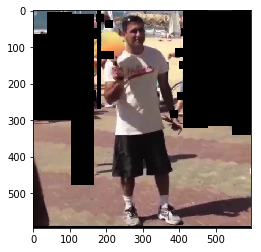

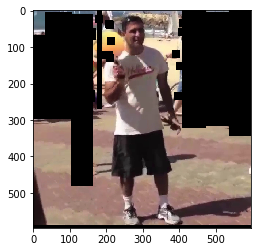

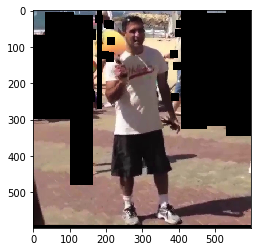

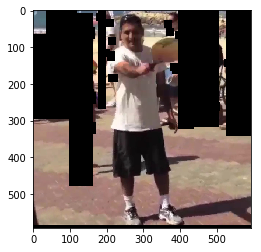

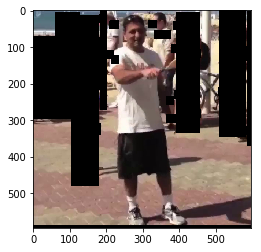

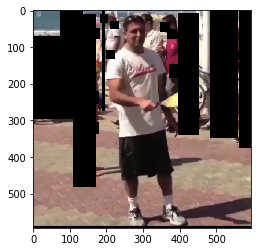

============= new sequence


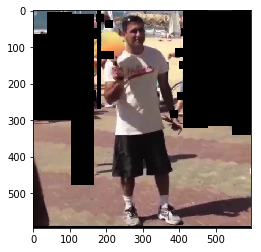

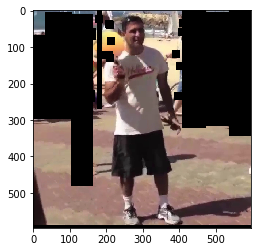

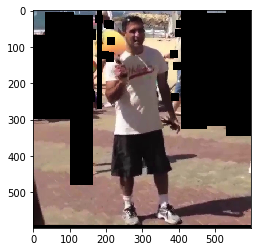

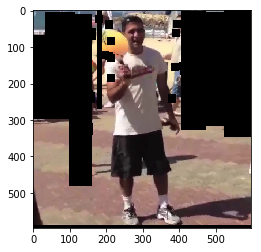

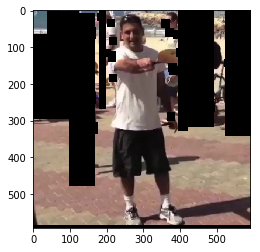

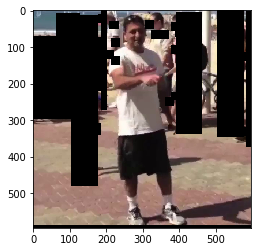

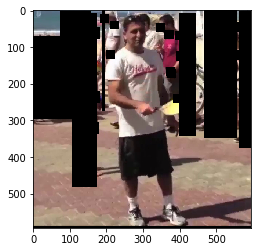

============= new sequence


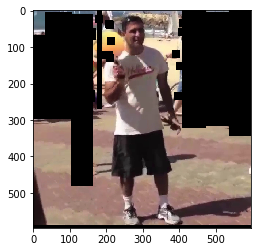

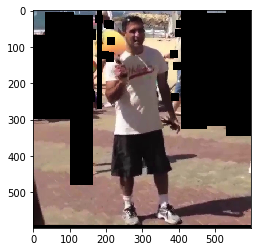

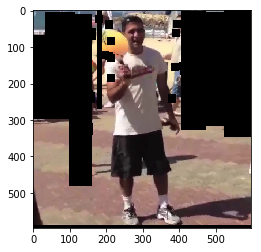

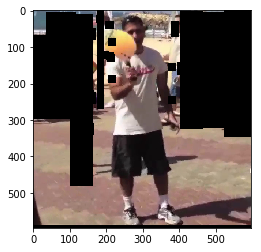

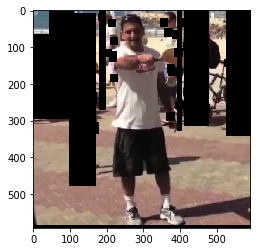

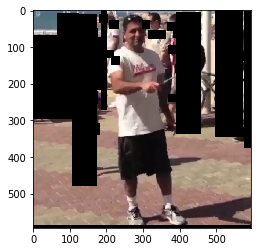

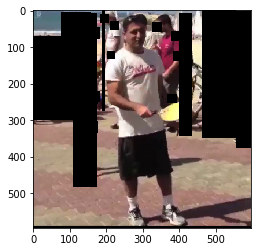

============= new sequence


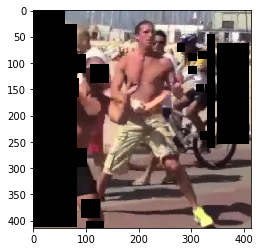

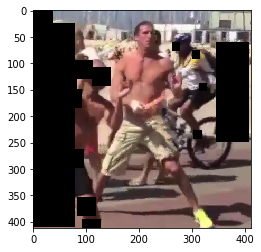

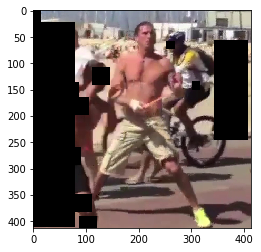

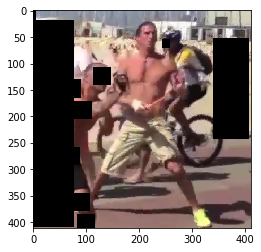

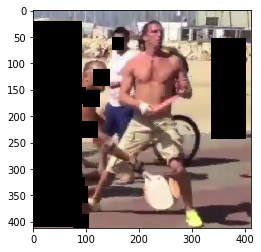

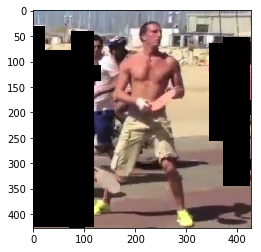

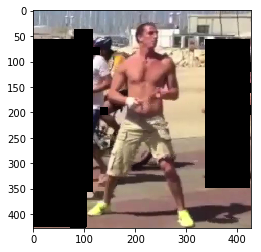

============= new sequence


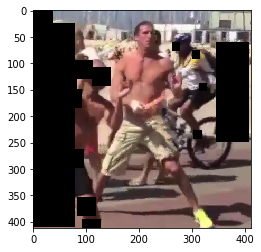

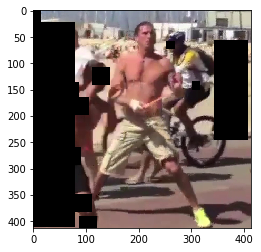

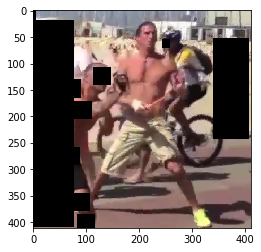

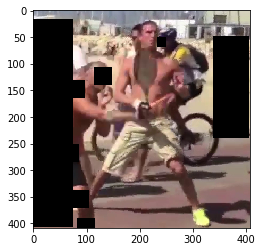

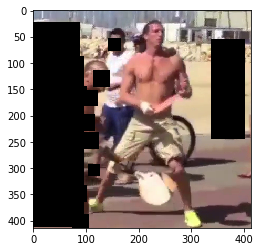

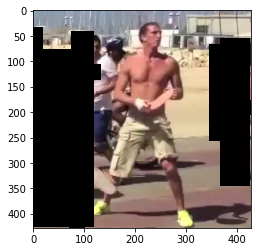

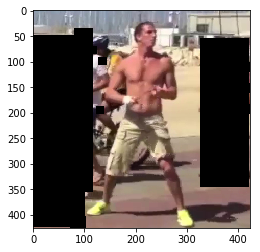

============= new sequence


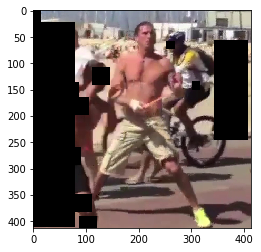

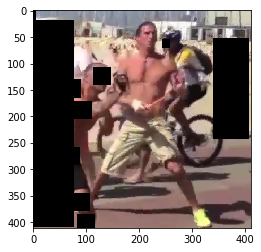

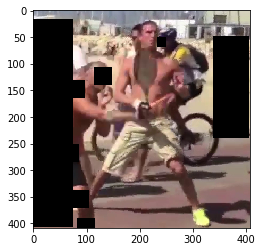

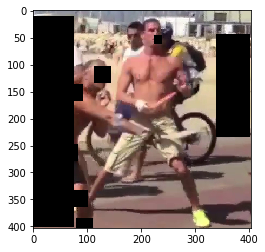

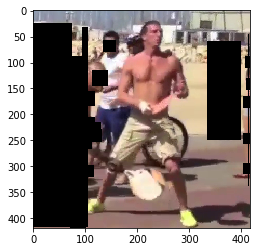

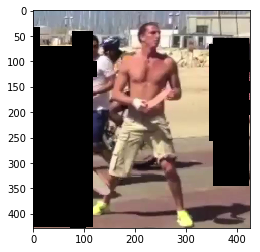

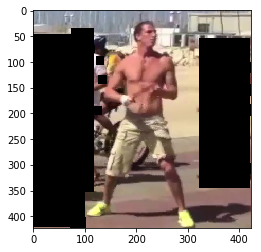

============= new sequence


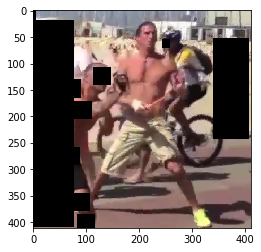

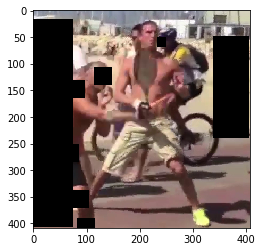

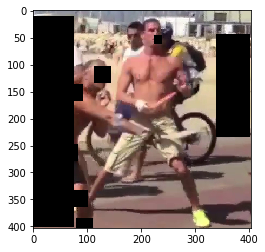

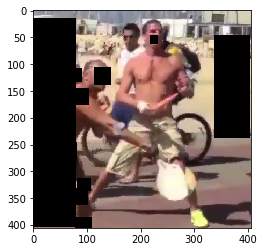

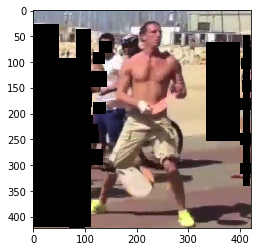

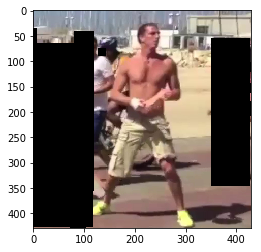

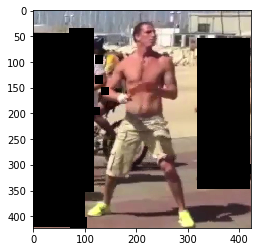

============= new sequence


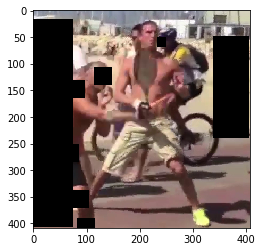

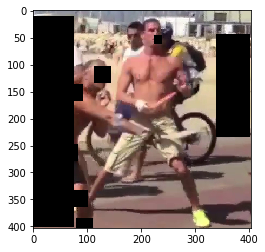

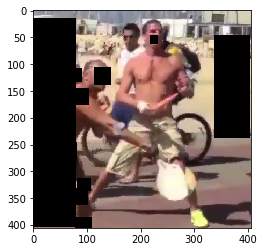

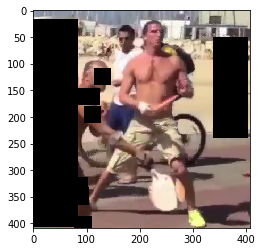

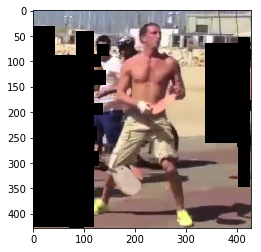

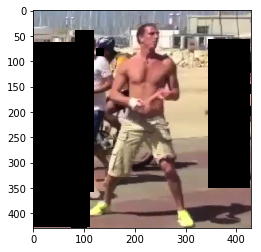

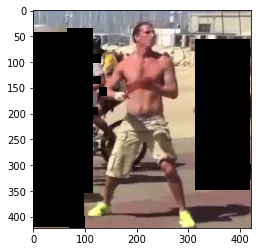

============= new sequence


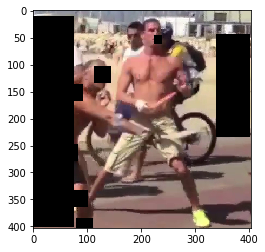

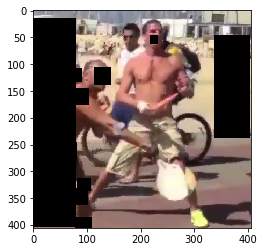

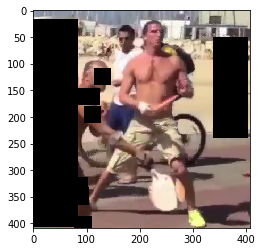

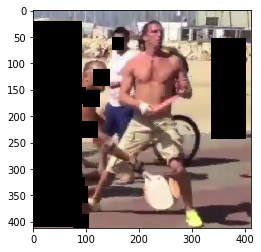

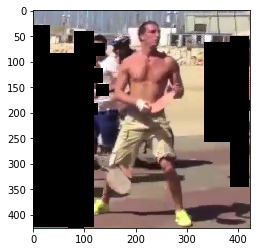

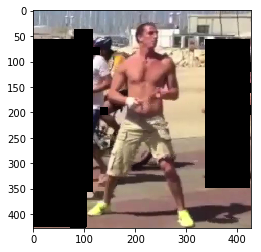

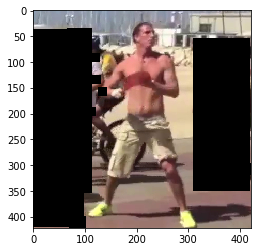

============= new sequence


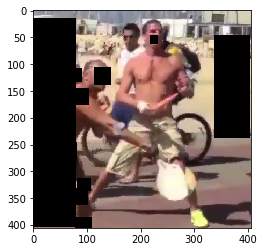

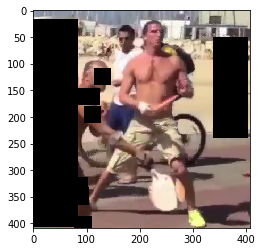

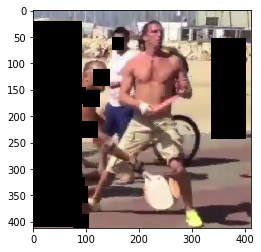

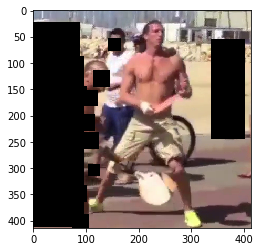

In [ ]:
for seqId in range(len(dp.training)):
    print("============= new sequence")
    for frameId in range(len(dp.training[seqId]['images'])):
        plt.imshow(dp.training[seqId]['images'][frameId])
        plt.show()


In [54]:
len(dp.training)

139

In [6]:
ptPro.trainsetSize()

10

In [7]:
ptPro.trainset[0]

{'imgFiles': ['dataset/posetrack/posetrack_data/images/train/015130_mpii_train/000036.jpg',
  'dataset/posetrack/posetrack_data/images/train/015130_mpii_train/000037.jpg',
  'dataset/posetrack/posetrack_data/images/train/015130_mpii_train/000038.jpg',
  'dataset/posetrack/posetrack_data/images/train/015130_mpii_train/000039.jpg',
  'dataset/posetrack/posetrack_data/images/train/015130_mpii_train/000040.jpg',
  'dataset/posetrack/posetrack_data/images/train/015130_mpii_train/000041.jpg',
  'dataset/posetrack/posetrack_data/images/train/015130_mpii_train/000042.jpg',
  'dataset/posetrack/posetrack_data/images/train/015130_mpii_train/000043.jpg',
  'dataset/posetrack/posetrack_data/images/train/015130_mpii_train/000044.jpg',
  'dataset/posetrack/posetrack_data/images/train/015130_mpii_train/000045.jpg',
  'dataset/posetrack/posetrack_data/images/train/015130_mpii_train/000046.jpg',
  'dataset/posetrack/posetrack_data/images/train/015130_mpii_train/000047.jpg',
  'dataset/posetrack/posetra

In [25]:
cocoSeq = ptPro.getTrainSequence(0)

In [46]:
len(cocoSeq['imgFiles'])

31

In [45]:
len(cocoSeq['annotations'][6])

31

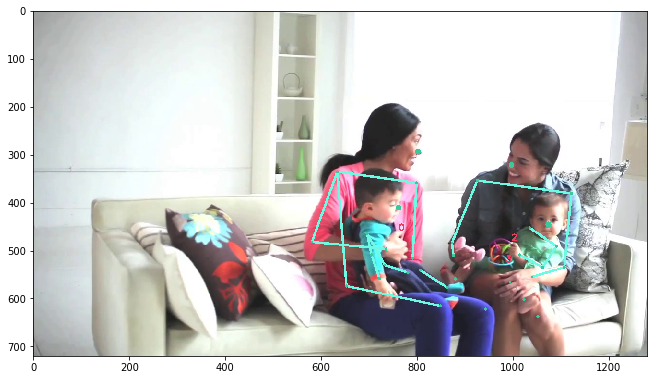

In [34]:
recordId = 4
cocoSeq = ptPro.trainset[recordId]
frameId = 23
img = mpimg.imread(cocoSeq['imgFiles'][frameId])

poses = []
for k in cocoSeq['annotations'].keys():
    poses.append(cocoSeq['annotations'][k][frameId]['pose'])

img = Drawer.draw_scene(img, poses, [i for i in range(len(poses))])

fig = plt.figure(figsize=[11, 11])
plt.imshow(img)
plt.show()


In [26]:
imgs = getImages(cocoSeq)

NameError: name 'getImages' is not defined

In [35]:
imgs[0]

{'has_no_densepose': True,
 'is_labeled': True,
 'file_name': 'images/val/024577_mpii_test/000000.jpg',
 'nframes': 134,
 'frame_id': 10245770000,
 'vid_id': '024577',
 'ignore_regions_y': [[75,
   151,
   141,
   148,
   151,
   162,
   160,
   175,
   175,
   190,
   200,
   205,
   223,
   226,
   235,
   237,
   258,
   258,
   0,
   7,
   48,
   68],
  [466, 716, 712],
  [26, 206, 217, 177, 40, 21],
  [87, 140, 205, 202, 138, 80]],
 'ignore_regions_x': [[498,
   542,
   601,
   657,
   732,
   775,
   830,
   863,
   895,
   957,
   997,
   1045,
   1085,
   1120,
   1157,
   1195,
   1266,
   1277,
   1272,
   528,
   533,
   537],
  [1271, 721, 1275],
  [31, 25, 121, 120, 122, 110],
  [163, 145, 182, 222, 233, 187]],
 'id': 10245770000}

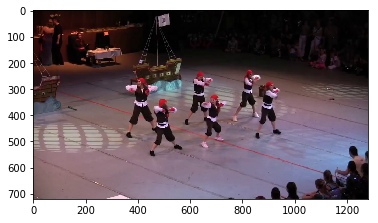

In [31]:
plt.imshow(readImage(imgs[0]))

In [40]:
annots = getAnnotations(cocoSeq)

In [41]:
annots

{0: [<src.utils.pose.Pose at 0x7f057e767390>,
 4: [<src.utils.pose.Pose at 0x7f057e7671d0>,
 8: [<src.utils.pose.Pose at 0x7f057e7672e8>,
 12: [<src.utils.pose.Pose at 0x7f057e767240>,
 16: [<src.utils.pose.Pose at 0x7f057e767630>,
 20: [<src.utils.pose.Pose at 0x7f057e7675c0>,
  <src.utils.pose.Pose at 0x7f057eaf96d8>]}

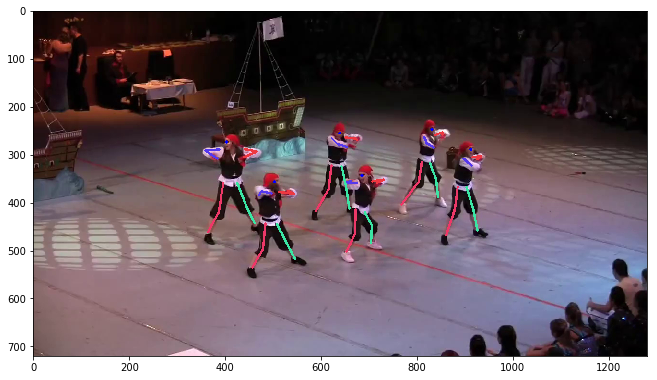

In [43]:
fig = plt.figure(figsize=[11, 11])

img = readImage(imgs[0])

for trackId in annots:
    pose = annots[trackId][0]
    img = Drawer().draw_2d_skeleton(img, pose)
    
plt.imshow(img)
plt.show()
